In [1]:
# Standard Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import joblib

# Data Profiling
from ydata_profiling import ProfileReport
import sweetviz as sv

# Statistical Analysis
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA

# Model Evaluation
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score

# Machine Learning Models
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import (
    RandomForestRegressor,
    GradientBoostingRegressor,
    VotingRegressor,
    StackingRegressor,
)
import xgboost as xgb
import lightgbm as lgb
from lightgbm import early_stopping

# Deep Learning
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam

# Optimization and Hyperparameter Tuning
import optuna
from optuna.integration import LightGBMPruningCallback

# Model Interpretability
import shap

# Experiment Tracking
import mlflow
import mlflow.sklearn

ImportError: DLL load failed while importing _multiarray_umath: The specified module could not be found.

ImportError: DLL load failed while importing _multiarray_umath: The specified module could not be found.

ImportError: numpy._core.multiarray failed to import

In [ ]:
# Load the datasets
previous_lives_training = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\previous_lives_training_data.csv")
registration_data_training = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\registration_data_training.csv")
previous_lives_test = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\previous_lives_test_data.csv")
registration_data_test = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\registration_data_test.csv")

: 

In [ ]:
# Check basic information about each dataset
print("previous_lives_training")
print('='*30)
previous_lives_training_info = previous_lives_training.info()
print("\n")
print("registration_data_training")
print('='*30)
registration_data_training_info = registration_data_training.info()
print("\n")
print("previous_lives_test")
print('='*30)
previous_lives_test_info = previous_lives_test.info()
print("\n")
print("registration_data_test")
print('='*30)
registration_data_test_info = registration_data_test.info()

previous_lives_training
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84941 entries, 0 to 84940
Data columns (total 11 columns):
 #   Column                              Non-Null Count  Dtype 
---  ------                              --------------  ----- 
 0   user_id                             84941 non-null  int64 
 1   registration_date                   84941 non-null  object
 2   registration_season_day             84941 non-null  int64 
 3   registration_country                84941 non-null  object
 4   registration_channel_detailed       84941 non-null  object
 5   registration_store                  84941 non-null  object
 6   registration_platform_specific      84941 non-null  object
 7   is_payer_lifetime                   84941 non-null  bool  
 8   days_active_lifetime                84941 non-null  int64 
 9   transaction_count_iap_lifetime      84941 non-null  int64 
 10  is_rewarded_video_watcher_lifetime  84941 non-null  bool  
dtypes: bool(2), int64(4), object(5

: 

In [ ]:
def missing_value_summary(data):
    # Calculate the number of missing values and their percentage
    missing_value = data.isnull().sum().reset_index()
    missing_value.columns = ['Variable', 'Number of Missing']
    missing_value['Percentage of Missing'] = (missing_value['Number of Missing'] / data.shape[0] * 100).round(2)

    # Sort the summary by the percentage of missing values in descending order
    missing_value = missing_value.sort_values(by='Percentage of Missing', ascending=False).reset_index(drop=True)

    return missing_value

: 

In [ ]:
# Display the missing value summary
missing_value_summary(previous_lives_training)

,Variable,Number of Missing,Percentage of Missing
0,user_id,0,0.0
1,registration_date,0,0.0
2,registration_season_day,0,0.0
3,registration_country,0,0.0
4,registration_channel_detailed,0,0.0
5,registration_store,0,0.0
6,registration_platform_specific,0,0.0
7,is_payer_lifetime,0,0.0
8,days_active_lifetime,0,0.0
9,transaction_count_iap_lifetime,0,0.0


: 

In [ ]:
# Check basic information about previous_lives_training dataset
print ("Rows     : " ,previous_lives_training.shape[0])
print ("Columns  : " ,previous_lives_training.shape[1])
print('='*30)
print ("Features : \n" ,previous_lives_training.columns.tolist())
print('='*30)
print ("Missing values :  ", previous_lives_training.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",previous_lives_training.nunique())

Rows     :  84941
Columns  :  11
Features : 
 ['user_id', 'registration_date', 'registration_season_day', 'registration_country', 'registration_channel_detailed', 'registration_store', 'registration_platform_specific', 'is_payer_lifetime', 'days_active_lifetime', 'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime']
Missing values :   0
Unique values :  
 user_id                               50000
registration_date                       699
registration_season_day                  28
registration_country                    187
registration_channel_detailed             3
registration_store                        6
registration_platform_specific            7
is_payer_lifetime                         2
days_active_lifetime                    519
transaction_count_iap_lifetime          127
is_rewarded_video_watcher_lifetime        2
dtype: int64


: 

In [ ]:
# Display the missing value summary
missing_value_summary(registration_data_training)

,Variable,Number of Missing,Percentage of Missing
0,registration_device_manufacturer,1813,3.63
1,avg_age_top_11_players,3,0.01
2,user_id,0,0.00
3,transaction_count_rewarded_video,0,0.00
4,training_count,0,0.00
5,avg_stars_top_3_players,0,0.00
6,avg_stars_top_11_players,0,0.00
7,money_stash,0,0.00
8,morale_spent,0,0.00
9,treatments_spent,0,0.00


: 

In [ ]:
# Check basic information about registration_data_training dataset
print ("Rows     : " ,registration_data_training.shape[0])
print ("Columns  : " ,registration_data_training.shape[1])
print('='*30)
print ("Features : \n" ,registration_data_training.columns.tolist())
print('='*30)
print ("Missing values :  ", registration_data_training.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",registration_data_training.nunique())

Rows     :  50000
Columns  :  30
Features : 
 ['user_id', 'registration_time_utc', 'registration_platform_specific', 'registration_country', 'registration_store', 'registration_season_day', 'registration_channel_detailed', 'registration_device_type', 'registration_device_manufacturer', 'session_count', 'playtime', 'number_of_devices_used', 'total_match_played_count', 'total_match_won_count', 'total_match_watched_count', 'transaction_count_iap', 'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash', 'tokens_bought', 'rests_stash', 'rests_spent', 'treatments_spent', 'morale_spent', 'money_stash', 'avg_stars_top_11_players', 'avg_stars_top_3_players', 'avg_age_top_11_players', 'training_count', 'days_active_first_28_days_after_registration']
Missing values :   1816
Unique values :  
 user_id                                         50000
registration_time_utc                           49410
registration_platform_specific                      7
registration_country             

: 

In [ ]:
# Display the missing value summary
missing_value_summary(previous_lives_test)

,Variable,Number of Missing,Percentage of Missing
0,user_id,0,0.0
1,registration_date,0,0.0
2,registration_season_day,0,0.0
3,registration_country,0,0.0
4,registration_channel_detailed,0,0.0
5,registration_store,0,0.0
6,registration_platform_specific,0,0.0
7,is_payer_lifetime,0,0.0
8,days_active_lifetime,0,0.0
9,transaction_count_iap_lifetime,0,0.0


: 

In [ ]:
# Check basic information about previous_lives_test dataset
print ("Rows     : " ,previous_lives_test.shape[0])
print ("Columns  : " ,previous_lives_test.shape[1])
print('='*30)
print ("Features : \n" ,previous_lives_test.columns.tolist())
print('='*30)
print ("Missing values :  ", previous_lives_test.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",previous_lives_test.nunique())

Rows     :  86113
Columns  :  11
Features : 
 ['user_id', 'registration_date', 'registration_season_day', 'registration_country', 'registration_channel_detailed', 'registration_store', 'registration_platform_specific', 'is_payer_lifetime', 'days_active_lifetime', 'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime']
Missing values :   0
Unique values :  
 user_id                               50000
registration_date                       724
registration_season_day                  28
registration_country                    199
registration_channel_detailed             3
registration_store                        6
registration_platform_specific            7
is_payer_lifetime                         2
days_active_lifetime                    530
transaction_count_iap_lifetime          122
is_rewarded_video_watcher_lifetime        2
dtype: int64


: 

In [ ]:
# Display the missing value summary
missing_value_summary(registration_data_test)

,Variable,Number of Missing,Percentage of Missing
0,registration_device_manufacturer,1659,3.32
1,user_id,0,0.00
2,transaction_count_iap,0,0.00
3,avg_age_top_11_players,1,0.00
4,avg_stars_top_3_players,0,0.00
5,avg_stars_top_11_players,0,0.00
6,money_stash,0,0.00
7,morale_spent,0,0.00
8,treatments_spent,0,0.00
9,rests_spent,0,0.00


: 

In [ ]:
# Check basic information about registration_data_test dataset
print ("Rows     : " ,registration_data_test.shape[0])
print ("Columns  : " ,registration_data_test.shape[1])
print('='*30)
print ("Features : \n" ,registration_data_test.columns.tolist())
print('='*30)
print ("Missing values :  ", registration_data_test.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",registration_data_test.nunique())

Rows     :  50000
Columns  :  29
Features : 
 ['user_id', 'registration_time_utc', 'registration_platform_specific', 'registration_country', 'registration_store', 'registration_season_day', 'registration_channel_detailed', 'registration_device_type', 'registration_device_manufacturer', 'session_count', 'playtime', 'number_of_devices_used', 'total_match_played_count', 'total_match_won_count', 'total_match_watched_count', 'transaction_count_iap', 'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash', 'tokens_bought', 'rests_stash', 'rests_spent', 'treatments_spent', 'morale_spent', 'money_stash', 'avg_stars_top_11_players', 'avg_stars_top_3_players', 'avg_age_top_11_players', 'training_count']
Missing values :   1660
Unique values :  
 user_id                             50000
registration_time_utc               49439
registration_platform_specific          7
registration_country                  187
registration_store                      7
registration_season_day          

: 

In [ ]:
# For 'registration_device_manufacturer', fill missing values with 'Unknown' in both training and test datasets
registration_data_training = registration_data_training.assign(
    registration_device_manufacturer=registration_data_training['registration_device_manufacturer'].fillna('Unknown')
)

registration_data_test = registration_data_test.assign(
    registration_device_manufacturer=registration_data_test['registration_device_manufacturer'].fillna('Unknown')
)

: 

In [ ]:
# For 'avg_age_top_11_players', find the mean in both training and test datasets
mean_age_top_11_train = registration_data_training['avg_age_top_11_players'].mean()
mean_age_top_11_test = registration_data_test['avg_age_top_11_players'].mean()
print(mean_age_top_11_train)
print(mean_age_top_11_test)

22.771246274776487
22.789435788715775


: 

In [ ]:
# For 'avg_age_top_11_players', fill missing values with the mean in both training and test datasets
registration_data_training = registration_data_training.assign(
    avg_age_top_11_players=registration_data_training['avg_age_top_11_players'].fillna(mean_age_top_11_train)
)

registration_data_test = registration_data_test.assign(
    avg_age_top_11_players=registration_data_test['avg_age_top_11_players'].fillna(mean_age_top_11_test)
)

: 

In [ ]:
# Verify that there are no missing values
print(registration_data_training.isnull().sum().values.sum())
print(registration_data_test.isnull().sum().values.sum())

0
0


: 

In [ ]:
# Convert date columns to datetime format
registration_data_training['registration_time_utc'] = pd.to_datetime(registration_data_training['registration_time_utc'])
previous_lives_training['registration_date'] = pd.to_datetime(previous_lives_training['registration_date'])
registration_data_test['registration_time_utc'] = pd.to_datetime(registration_data_test['registration_time_utc'])
previous_lives_test['registration_date'] = pd.to_datetime(previous_lives_test['registration_date'])

: 

In [ ]:
# Encode boolean columns to 0 and 1
bool_columns = ['is_payer_lifetime', 'is_rewarded_video_watcher_lifetime']

# Apply encoding in both training and test datasets where applicable
for col in bool_columns:
    if col in previous_lives_training.columns:
        previous_lives_training[col] = previous_lives_training[col].astype(int)
    if col in previous_lives_test.columns:
        previous_lives_test[col] = previous_lives_test[col].astype(int)

: 

In [ ]:
# Describe the 'registration_data_training' dataset
registration_data_training.describe().T

,count,mean,min,25%,50%,75%,max,std
user_id,50000.0,109844.2391,5.0,55070.75,109571.0,165091.75,218956.0,63219.003941
registration_time_utc,50000,2024-06-01 04:12:22.393839872,2024-05-19 00:00:59,2024-05-25 05:39:13,2024-05-31 18:21:27.500000,2024-06-08 01:50:36.750000128,2024-06-15 23:59:50,NaN
registration_season_day,50000.0,13.61398,1.0,7.0,13.0,21.0,28.0,8.048579
session_count,50000.0,2.25444,0.0,1.0,2.0,3.0,52.0,2.107337
playtime,50000.0,1938928.0555,0.0,352700.5,1151846.0,2609019.75,58173586.0,2452801.151514
number_of_devices_used,50000.0,1.0032,0.0,1.0,1.0,1.0,4.0,0.11606
total_match_played_count,50000.0,1.01376,0.0,0.0,1.0,1.0,29.0,1.624298
total_match_won_count,50000.0,0.70982,0.0,0.0,0.0,1.0,17.0,1.223685
total_match_watched_count,50000.0,0.35814,0.0,0.0,0.0,0.0,19.0,0.951953
transaction_count_iap,50000.0,0.0204,0.0,0.0,0.0,0.0,15.0,0.252161


: 

In [ ]:
# Calculate the count and percentage of negative values directly for both 'tokens_stash' and 'money_stash'
negative_tokens_count = (registration_data_training['tokens_stash'] < 0).sum()
negative_tokens_percentage = (negative_tokens_count / len(registration_data_training)) * 100

negative_money_count = (registration_data_training['money_stash'] < 0).sum()
negative_money_percentage = (negative_money_count / len(registration_data_training)) * 100

# Compile the results
negative_values_summary = {
    'Negative Tokens Count': negative_tokens_count,
    'Negative Tokens Percentage': negative_tokens_percentage,
    'Negative Money Count': negative_money_count,
    'Negative Money Percentage': negative_money_percentage
}

negative_values_summary

{'Negative Tokens Count': np.int64(14),
 'Negative Tokens Percentage': np.float64(0.027999999999999997),
 'Negative Money Count': np.int64(24),
 'Negative Money Percentage': np.float64(0.048)}

: 

In [ ]:
# Replace negative values with zero in 'tokens_stash' and 'money_stash'
registration_data_training['tokens_stash'] = registration_data_training['tokens_stash'].apply(lambda x: max(x, 0))
registration_data_training['money_stash'] = registration_data_training['money_stash'].apply(lambda x: max(x, 0))

# Verify replacement by checking the minimum values of these columns
min_tokens_stash = registration_data_training['tokens_stash'].min()
min_money_stash = registration_data_training['money_stash'].min()

min_tokens_stash, min_money_stash

(np.int64(0), np.int64(0))

: 

In [ ]:
# Describe the 'previous_lives_training' dataset
previous_lives_training.describe().T

,count,mean,min,25%,50%,75%,max,std
user_id,84941.0,105724.313312,5.0,51738.0,100428.0,161383.0,218956.0,63599.357303
registration_date,84941,2023-03-02 06:52:58.422670080,2022-04-01 00:00:00,2022-09-13 00:00:00,2023-03-08 00:00:00,2023-08-16 00:00:00,2024-05-18 00:00:00,NaN
registration_season_day,84941.0,14.245759,1.0,7.0,14.0,21.0,28.0,8.085758
is_payer_lifetime,84941.0,0.080738,0.0,0.0,0.0,0.0,1.0,0.272435
days_active_lifetime,84941.0,25.035801,1.0,2.0,6.0,24.0,650.0,50.654498
transaction_count_iap_lifetime,84941.0,0.624928,0.0,0.0,0.0,0.0,313.0,4.969772
is_rewarded_video_watcher_lifetime,84941.0,0.498664,0.0,0.0,0.0,1.0,1.0,0.500001


: 

In [ ]:
# Describe the 'registration_data_test' dataset
registration_data_test.describe().T

,count,mean,min,25%,50%,75%,max,std
user_id,50000.0,406616.482,300004.0,353459.5,406896.0,459752.75,512713.0,61248.729756
registration_time_utc,50000,2024-06-29 07:45:37.307360,2024-06-16 00:03:15,2024-06-22 05:42:12.500000,2024-06-29 01:08:58,2024-07-06 10:32:28.500000,2024-07-13 23:59:47,NaN
registration_season_day,50000.0,13.75538,1.0,7.0,14.0,21.0,28.0,8.142787
session_count,50000.0,2.21498,0.0,1.0,1.0,3.0,38.0,2.080291
playtime,50000.0,1996998.76292,0.0,315819.0,1115409.5,2691061.5,56791716.0,2626581.168489
number_of_devices_used,50000.0,1.00194,0.0,1.0,1.0,1.0,4.0,0.119233
total_match_played_count,50000.0,1.88208,0.0,0.0,1.0,2.0,71.0,3.933518
total_match_won_count,50000.0,1.18946,0.0,0.0,0.0,1.0,38.0,2.649284
total_match_watched_count,50000.0,0.44668,0.0,0.0,0.0,1.0,20.0,1.003104
transaction_count_iap,50000.0,0.02242,0.0,0.0,0.0,0.0,10.0,0.253848


: 

In [ ]:
# Calculate the count and percentage of negative values for both 'tokens_stash', 'money_stash', and 'rests_stash' in the test dataset
negative_tokens_count_test = (registration_data_test['tokens_stash'] < 0).sum()
negative_tokens_percentage_test = (negative_tokens_count_test / len(registration_data_test)) * 100

negative_money_count_test = (registration_data_test['money_stash'] < 0).sum()
negative_money_percentage_test = (negative_money_count_test / len(registration_data_test)) * 100

negative_rests_count_test = (registration_data_test['rests_stash'] < 0).sum()
negative_rests_percentage_test = (negative_rests_count_test / len(registration_data_test)) * 100

# Compile the results
negative_values_summary_test = {
    'Negative Tokens Count': negative_tokens_count_test,
    'Negative Tokens Percentage': negative_tokens_percentage_test,
    'Negative Money Count': negative_money_count_test,
    'Negative Money Percentage': negative_money_percentage_test,
    'Negative Rests Count': negative_rests_count_test,
    'Negative Rests Percentage': negative_rests_percentage_test
}

negative_values_summary_test

{'Negative Tokens Count': np.int64(10),
 'Negative Tokens Percentage': np.float64(0.02),
 'Negative Money Count': np.int64(37),
 'Negative Money Percentage': np.float64(0.074),
 'Negative Rests Count': np.int64(1),
 'Negative Rests Percentage': np.float64(0.002)}

: 

In [ ]:
# Replace negative values with zero in 'tokens_stash', 'money_stash', and 'rests_stash' in the test dataset
registration_data_test['tokens_stash'] = registration_data_test['tokens_stash'].apply(lambda x: max(x, 0))
registration_data_test['money_stash'] = registration_data_test['money_stash'].apply(lambda x: max(x, 0))
registration_data_test['rests_stash'] = registration_data_test['rests_stash'].apply(lambda x: max(x, 0))

# Verify replacement by checking the minimum values of these columns
min_tokens_stash_test = registration_data_test['tokens_stash'].min()
min_money_stash_test = registration_data_test['money_stash'].min()
min_rests_stash_test = registration_data_test['rests_stash'].min()

min_tokens_stash_test, min_money_stash_test, min_rests_stash_test

(np.int64(0), np.int64(0), np.int64(0))

: 

In [ ]:
# Describe the 'previous_lives_test' dataset
previous_lives_test.describe().T

,count,mean,min,25%,50%,75%,max,std
user_id,86113.0,402773.135136,300004.0,349829.0,397061.0,456579.0,512713.0,61894.428895
registration_date,86113,2023-03-17 23:52:22.480229632,2022-04-01 00:00:00,2022-09-22 00:00:00,2023-03-25 00:00:00,2023-08-31 00:00:00,2024-03-24 00:00:00,NaN
registration_season_day,86113.0,14.264014,1.0,7.0,14.0,21.0,28.0,8.08861
is_payer_lifetime,86113.0,0.079605,0.0,0.0,0.0,0.0,1.0,0.270682
days_active_lifetime,86113.0,23.868011,1.0,2.0,6.0,22.0,683.0,50.28448
transaction_count_iap_lifetime,86113.0,0.603637,0.0,0.0,0.0,0.0,376.0,5.093712
is_rewarded_video_watcher_lifetime,86113.0,0.480369,0.0,0.0,0.0,1.0,1.0,0.499617


: 

In [ ]:
# Convert 'playtime' from milliseconds to minutes in both training and test datasets
registration_data_training['playtime'] = registration_data_training['playtime'] / 60000  # 1 minute = 60,000 milliseconds
registration_data_test['playtime'] = registration_data_test['playtime'] / 60000

# Verify the transformation by checking the statistics for 'playtime' in minutes
playtime_stats_training = registration_data_training['playtime'].describe()
playtime_stats_test = registration_data_test['playtime'].describe()

print(f"Playtime Training Statistics \n{playtime_stats_training}")
print(f"\nPlaytime Test Statistics \n{playtime_stats_test}")

(count    50000.000000
 mean        32.315468
 std         40.880019
 min          0.000000
 25%          5.878342
 50%         19.197433
 75%         43.483663
 max        969.559767
 Name: playtime, dtype: float64,
 count    50000.000000
 mean        33.283313
 std         43.776353
 min          0.000000
 25%          5.263650
 50%         18.590158
 75%         44.851025
 max        946.528600
 Name: playtime, dtype: float64)

: 

In [ ]:
# Aggregate the `previous_lives_training` data by `user_id`
previous_lives_training_aggregated = previous_lives_training.groupby('user_id').agg({    
    'is_payer_lifetime': 'max',                           # Has the user ever made an in-app purchase
    'days_active_lifetime': 'sum',                        # Total days active across all lives
    'transaction_count_iap_lifetime': 'sum',              # Total transactions across lives
    'is_rewarded_video_watcher_lifetime': 'max'           # Has the user ever watched a rewarded video
}).reset_index()

: 

In [ ]:
# Aggregate the `previous_lives_test` data by `user_id` using the same logic
previous_lives_test_aggregated = previous_lives_test.groupby('user_id').agg({    
    'is_payer_lifetime': 'max',                           # Has the user ever made an in-app purchase
    'days_active_lifetime': 'sum',                        # Total days active across all lives
    'transaction_count_iap_lifetime': 'sum',              # Total transactions across lives
    'is_rewarded_video_watcher_lifetime': 'max'           # Has the user ever watched a rewarded video
}).reset_index()

: 

In [ ]:
# Verify the structure and summary of the aggregated training and test data
previous_lives_training_aggregated.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,109844.23910,63219.003941,5.0,55070.75,109571.0,165091.75,218956.0
is_payer_lifetime,50000.0,0.12350,0.329014,0.0,0.00,0.0,0.00,1.0
days_active_lifetime,50000.0,42.53132,66.123853,1.0,4.00,17.0,51.00,650.0
transaction_count_iap_lifetime,50000.0,1.06164,6.763369,0.0,0.00,0.0,0.00,335.0
is_rewarded_video_watcher_lifetime,50000.0,0.63244,0.482146,0.0,0.00,1.0,1.00,1.0


: 

In [ ]:
# Verify the structure and summary of the aggregated training and test data
previous_lives_test_aggregated.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,406616.48200,61248.729756,300004.0,353459.5,406896.0,459752.75,512713.0
is_payer_lifetime,50000.0,0.12230,0.327635,0.0,0.0,0.0,0.00,1.0
days_active_lifetime,50000.0,41.10692,66.363991,1.0,4.0,15.0,48.00,683.0
transaction_count_iap_lifetime,50000.0,1.03962,7.179864,0.0,0.0,0.0,0.00,700.0
is_rewarded_video_watcher_lifetime,50000.0,0.61140,0.487437,0.0,0.0,1.0,1.00,1.0


: 

In [ ]:
# Merge the aggregated previous lives data with registration data for both training and test sets

# Training merge
training_data = pd.merge(registration_data_training, previous_lives_training_aggregated, on='user_id', how='left')

# Test merge
test_data = pd.merge(registration_data_test, previous_lives_test_aggregated, on='user_id', how='left')

# Verify the structure and summary of the merged datasets
training_data_info = training_data.describe().T
test_data_info = test_data.describe().T

: 

In [ ]:
training_data_info

,count,mean,min,25%,50%,75%,max,std
user_id,50000.0,109844.2391,5.0,55070.75,109571.0,165091.75,218956.0,63219.003941
registration_time_utc,50000,2024-06-01 04:12:22.393839872,2024-05-19 00:00:59,2024-05-25 05:39:13,2024-05-31 18:21:27.500000,2024-06-08 01:50:36.750000128,2024-06-15 23:59:50,NaN
registration_season_day,50000.0,13.61398,1.0,7.0,13.0,21.0,28.0,8.048579
session_count,50000.0,2.25444,0.0,1.0,2.0,3.0,52.0,2.107337
playtime,50000.0,32.315468,0.0,5.878342,19.197433,43.483663,969.559767,40.880019
number_of_devices_used,50000.0,1.0032,0.0,1.0,1.0,1.0,4.0,0.11606
total_match_played_count,50000.0,1.01376,0.0,0.0,1.0,1.0,29.0,1.624298
total_match_won_count,50000.0,0.70982,0.0,0.0,0.0,1.0,17.0,1.223685
total_match_watched_count,50000.0,0.35814,0.0,0.0,0.0,0.0,19.0,0.951953
transaction_count_iap,50000.0,0.0204,0.0,0.0,0.0,0.0,15.0,0.252161


: 

In [ ]:
test_data_info

,count,mean,min,25%,50%,75%,max,std
user_id,50000.0,406616.482,300004.0,353459.5,406896.0,459752.75,512713.0,61248.729756
registration_time_utc,50000,2024-06-29 07:45:37.307360,2024-06-16 00:03:15,2024-06-22 05:42:12.500000,2024-06-29 01:08:58,2024-07-06 10:32:28.500000,2024-07-13 23:59:47,NaN
registration_season_day,50000.0,13.75538,1.0,7.0,14.0,21.0,28.0,8.142787
session_count,50000.0,2.21498,0.0,1.0,1.0,3.0,38.0,2.080291
playtime,50000.0,33.283313,0.0,5.26365,18.590158,44.851025,946.5286,43.776353
number_of_devices_used,50000.0,1.00194,0.0,1.0,1.0,1.0,4.0,0.119233
total_match_played_count,50000.0,1.88208,0.0,0.0,1.0,2.0,71.0,3.933518
total_match_won_count,50000.0,1.18946,0.0,0.0,0.0,1.0,38.0,2.649284
total_match_watched_count,50000.0,0.44668,0.0,0.0,0.0,1.0,20.0,1.003104
transaction_count_iap,50000.0,0.02242,0.0,0.0,0.0,0.0,10.0,0.253848


: 

In [ ]:
# Select numerical columns for outlier detection
numeric_columns_training = training_data.select_dtypes(include=['int64', 'float64']).columns.tolist()
numeric_columns_training

['user_id',
 'registration_season_day',
 'session_count',
 'playtime',
 'number_of_devices_used',
 'total_match_played_count',
 'total_match_won_count',
 'total_match_watched_count',
 'transaction_count_iap',
 'transaction_count_rewarded_video',
 'tokens_spent',
 'tokens_stash',
 'tokens_bought',
 'rests_stash',
 'rests_spent',
 'treatments_spent',
 'morale_spent',
 'money_stash',
 'avg_stars_top_11_players',
 'avg_stars_top_3_players',
 'avg_age_top_11_players',
 'training_count',
 'days_active_first_28_days_after_registration',
 'is_payer_lifetime',
 'days_active_lifetime',
 'transaction_count_iap_lifetime',
 'is_rewarded_video_watcher_lifetime']

: 

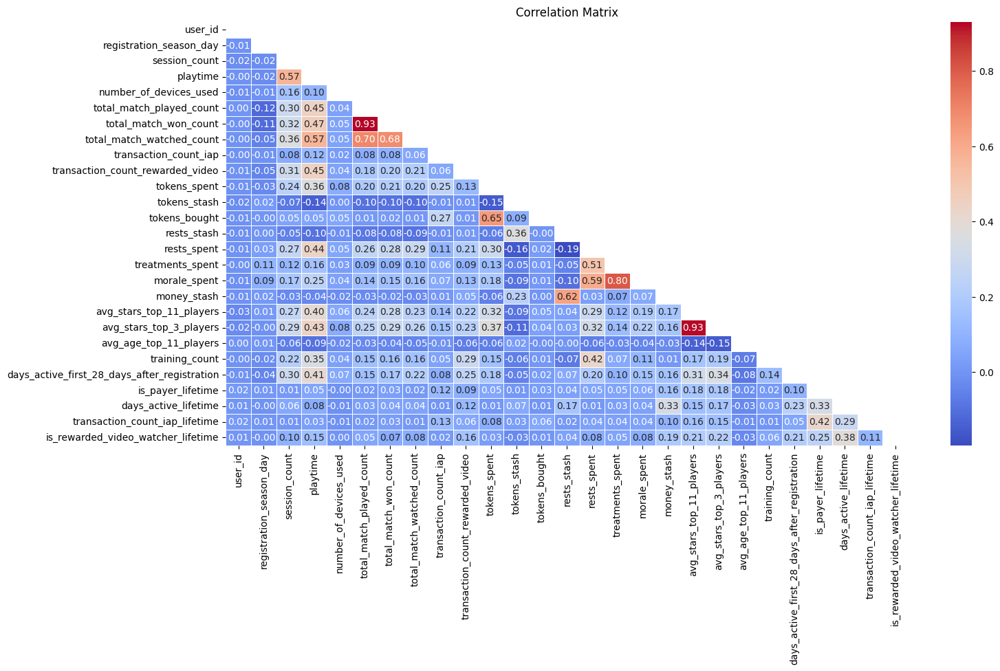

: 

In [ ]:
# Correlation Analysis
correlation_matrix = training_data[numeric_columns_training].corr()
plt.figure(figsize=(16, 8))
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, annot=True, mask=mask, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [ ]:
# Identify key correlated pairs (threshold > 0.7 for strong correlation)
correlation_threshold = 0.7
key_correlated_pairs = []

# Iterate over the correlation matrix and find pairs above the threshold
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > correlation_threshold:
            feature_1 = correlation_matrix.index[i]
            feature_2 = correlation_matrix.columns[j]
            correlation_value = correlation_matrix.iloc[i, j]
            key_correlated_pairs.append((feature_1, feature_2, correlation_value))

# Convert to DataFrame for better readability and display
key_correlated_pairs_df = pd.DataFrame(key_correlated_pairs, columns=["Feature 1", "Feature 2", "Correlation"])
key_correlated_pairs_df = key_correlated_pairs_df.sort_values(by="Correlation", ascending=False).reset_index(drop=True)

key_correlated_pairs_df

,Feature 1,Feature 2,Correlation
0,total_match_played_count,total_match_won_count,0.930722
1,avg_stars_top_11_players,avg_stars_top_3_players,0.925473
2,treatments_spent,morale_spent,0.804064


: 

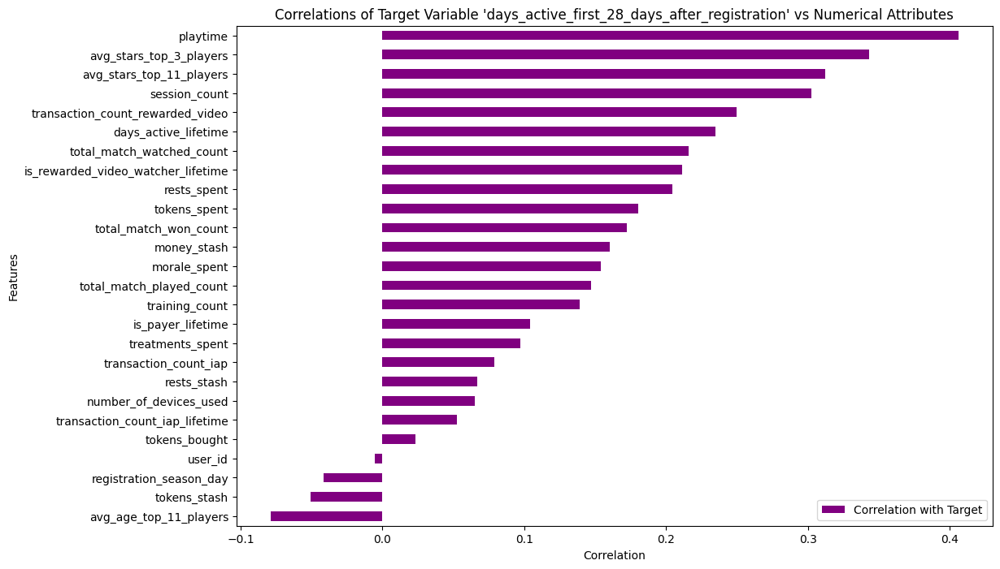

: 

In [ ]:
# Extract correlation values between each feature and the target variable 'days_active_first_28_days_after_registration'
target_correlation = correlation_matrix['days_active_first_28_days_after_registration'].drop('days_active_first_28_days_after_registration')

# Sort correlations by absolute value to see the strongest correlations at the top
target_correlation_sorted = target_correlation.sort_values(ascending=True).to_frame(name='Correlation with Target')

# Plotting the correlations
target_correlation_sorted.plot(kind='barh', figsize=(12,8), color='purple')
plt.title("Correlations of Target Variable 'days_active_first_28_days_after_registration' vs Numerical Attributes")
plt.xlabel("Correlation")
plt.ylabel("Features")
plt.show()

In [ ]:
# Select only numeric features
numeric_features = training_data.select_dtypes(include=['float64', 'int64']).columns

# Standardize the data for better VIF calculations
scaler = StandardScaler()
scaled_data = scaler.fit_transform(training_data[numeric_features])

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data['Feature'] = numeric_features
vif_data['VIF'] = [variance_inflation_factor(scaled_data, i) for i in range(scaled_data.shape[1])]

# Display features with VIF scores
vif_data.sort_values(by="VIF", ascending=False)

,Feature,VIF
5,total_match_played_count,8.030878
19,avg_stars_top_3_players,7.938417
6,total_match_won_count,7.859575
18,avg_stars_top_11_players,7.203526
16,morale_spent,3.330233
15,treatments_spent,2.920185
10,tokens_spent,2.731067
3,playtime,2.716444
7,total_match_watched_count,2.360230
14,rests_spent,2.307228


: 

In [ ]:
target_correlation_sorted.sort_values(by="Correlation with Target", ascending=False)

,Correlation with Target
playtime,0.405866
avg_stars_top_3_players,0.343371
avg_stars_top_11_players,0.312195
session_count,0.302213
transaction_count_rewarded_video,0.249702
days_active_lifetime,0.234768
total_match_watched_count,0.215645
is_rewarded_video_watcher_lifetime,0.211278
rests_spent,0.204557
tokens_spent,0.180192


: 

In [ ]:
# Drop 'total_match_won_count', 'avg_stars_top_11_players' and'treatments_spent' as they were identified as redundant
training_data = training_data.drop(['total_match_won_count', 'avg_stars_top_11_players', 'treatments_spent'], axis=1)

# Verify the features were dropped successfully
print("Remaining columns:", training_data.columns)

Remaining columns: Index(['user_id', 'registration_time_utc', 'registration_platform_specific',
       'registration_country', 'registration_store', 'registration_season_day',
       'registration_channel_detailed', 'registration_device_type',
       'registration_device_manufacturer', 'session_count', 'playtime',
       'number_of_devices_used', 'total_match_played_count',
       'total_match_watched_count', 'transaction_count_iap',
       'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash',
       'tokens_bought', 'rests_stash', 'rests_spent', 'morale_spent',
       'money_stash', 'avg_stars_top_3_players', 'avg_age_top_11_players',
       'training_count', 'days_active_first_28_days_after_registration',
       'is_payer_lifetime', 'days_active_lifetime',
       'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime'],
      dtype='object')


: 

In [ ]:
numeric_columns_training = training_data.select_dtypes(include=['int64', 'float64']).columns.tolist()

: 

In [ ]:
# Calculate the IQR for each numerical column
Q1 = training_data[numeric_columns_training].quantile(0.25)
Q3 = training_data[numeric_columns_training].quantile(0.75)
IQR = Q3 - Q1

# Define lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify potential outliers
outliers = ((training_data[numeric_columns_training] < lower_bound) | (training_data[numeric_columns_training] > upper_bound)).any(axis=1)
outliers.value_counts()

True     28567
False    21433
Name: count, dtype: int64

: 

In [ ]:
# Calculate percentage of outliers for each numerical column in the training dataset
outlier_percentage = {}

# Calculate IQR, bounds, and outlier percentage per column
for col in numeric_columns_training:
    Q1 = training_data[col].quantile(0.25)
    Q3 = training_data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = ((training_data[col] < lower_bound) | (training_data[col] > upper_bound))
    outlier_percentage[col] = (outliers.sum() / len(training_data)) * 100

# Convert to a DataFrame for easier viewing
outlier_percentage_df = pd.DataFrame(list(outlier_percentage.items()), columns=['Column', 'Outlier Percentage'])
outlier_percentage_df

,Column,Outlier Percentage
0,user_id,0.000
1,registration_season_day,0.000
2,session_count,4.272
3,playtime,5.928
4,number_of_devices_used,1.248
5,total_match_played_count,7.386
6,total_match_watched_count,21.432
7,transaction_count_iap,1.110
8,transaction_count_rewarded_video,15.076
9,tokens_spent,1.206


: 

In [ ]:
# Export the merged training and test datasets to CSV
training_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed/merged_training_data.csv", index=False)
test_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed/merged_test_data.csv", index=False)

: 

In [ ]:
# Use the power of ydata_profiling library to understand our training data
profile = ProfileReport(training_data, title="Profiling Report")
profile.to_notebook_iframe()
profile.to_file(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\ydata_training_data.html")
profile.to_file(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\ydata_training_data.json")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

: 

                                             |          | [  0%]   00:00 -> (? left)

Report C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_training_data.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



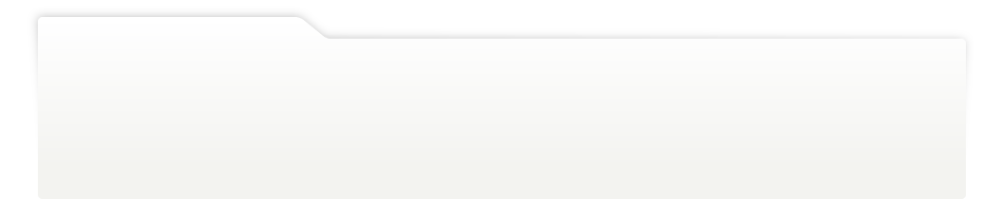
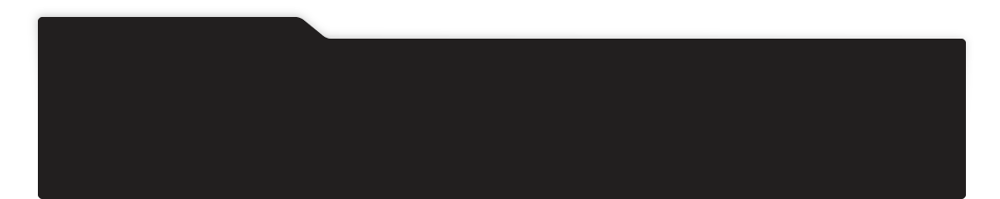
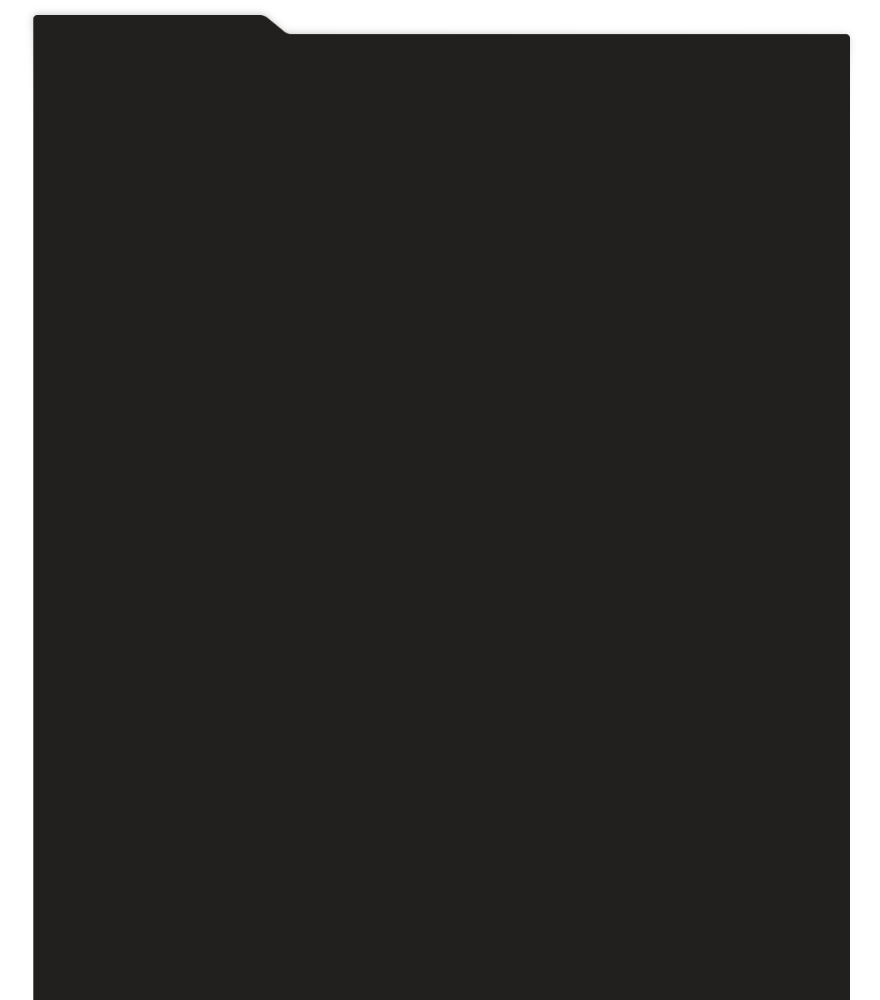
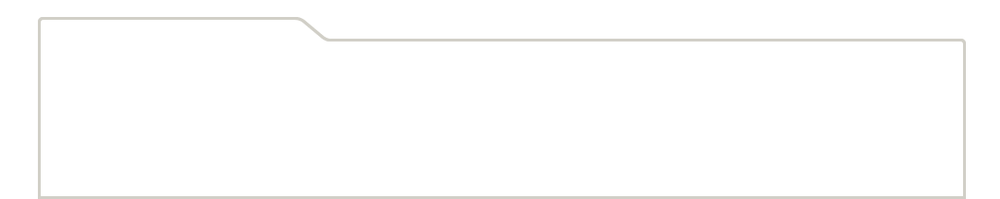
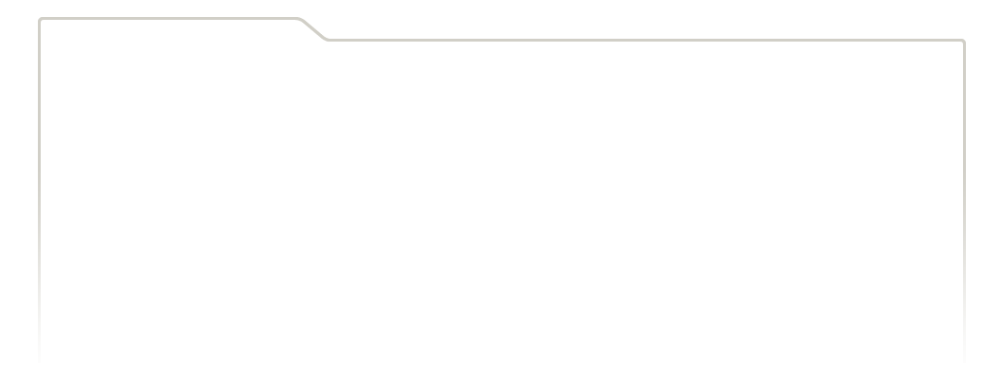
...
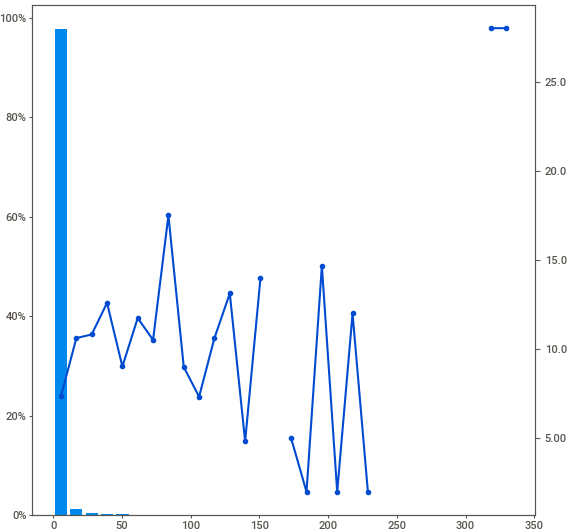
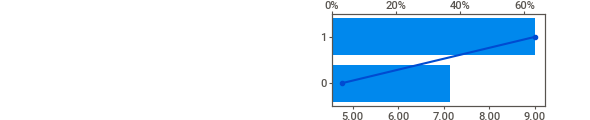
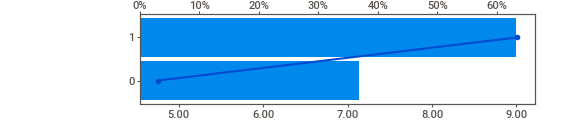
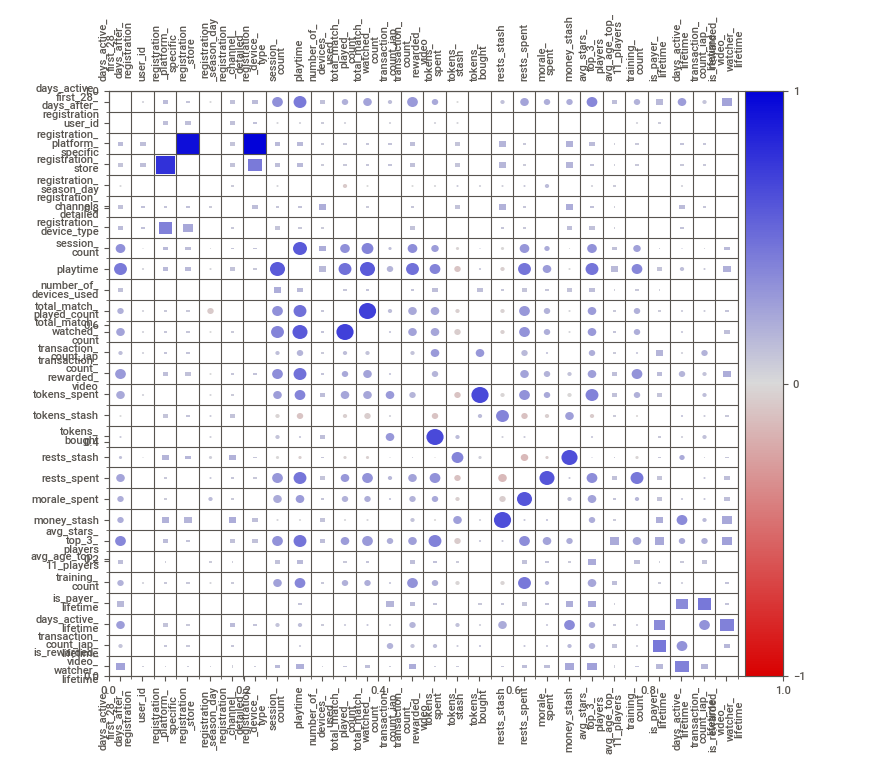
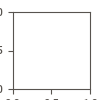

: 

In [ ]:
# Use the power of sweetviz library to understand our training data in relevance to the target variable
my_report = sv.analyze(training_data, target_feat='days_active_first_28_days_after_registration')
my_report.show_html(r'C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_training_data.html')

my_report.show_notebook(w=None,
                h=None,
                scale=None,
                layout='widescreen',
                filepath=None)

                                             |          | [  0%]   00:00 -> (? left)

Report C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_compare.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



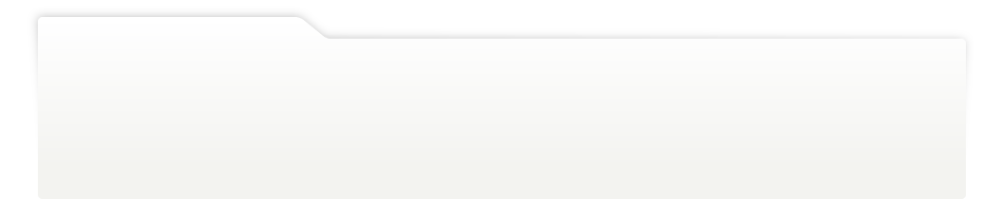
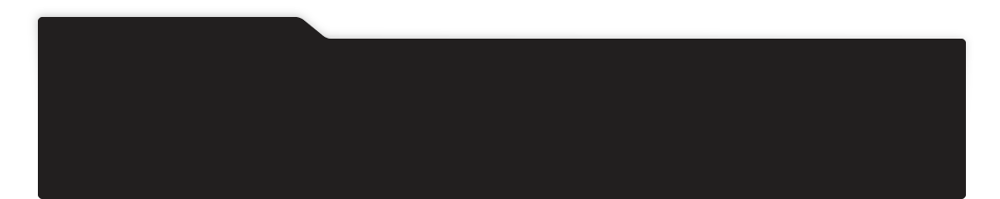
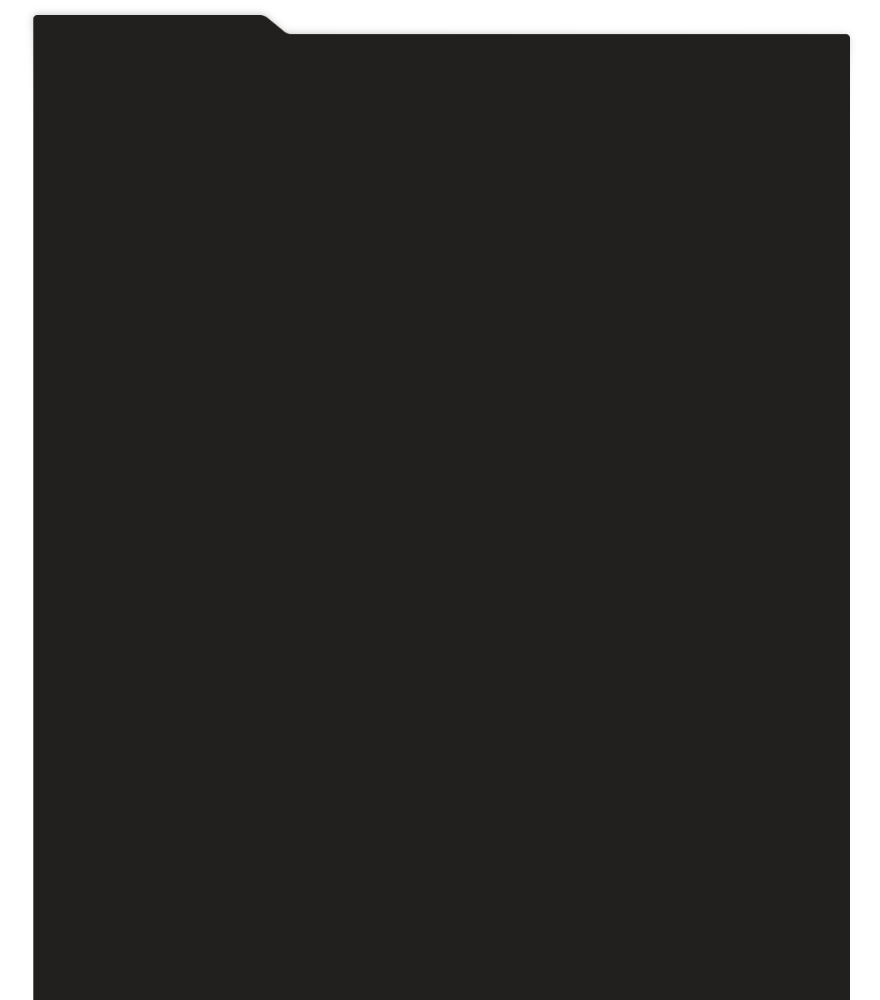
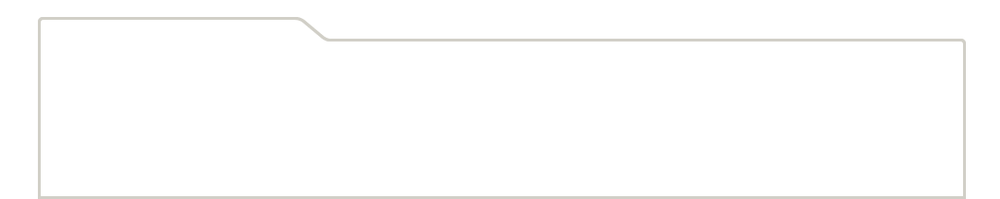
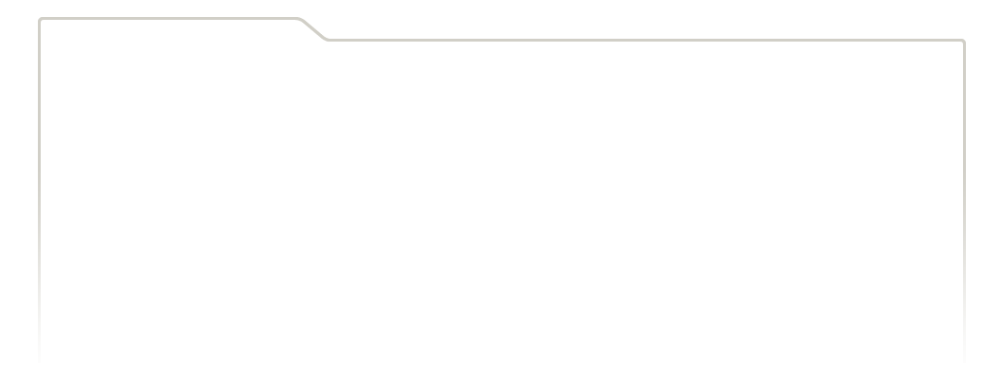
...
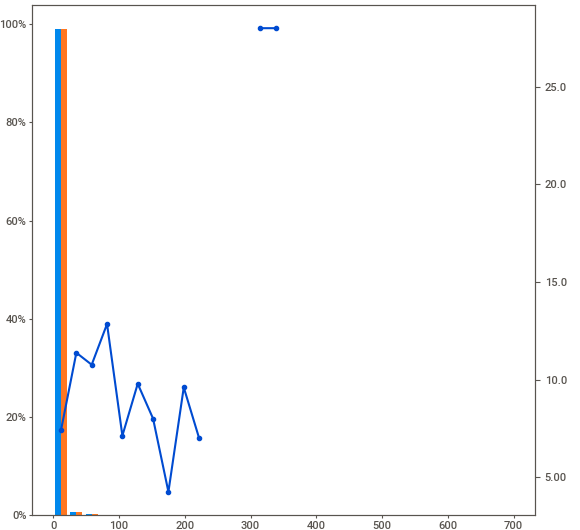
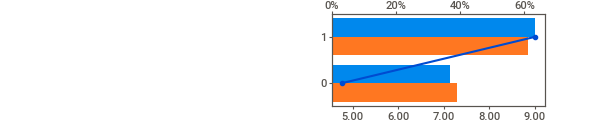
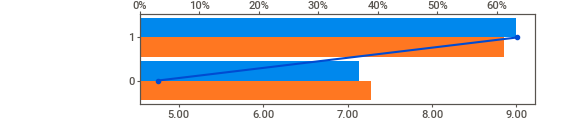
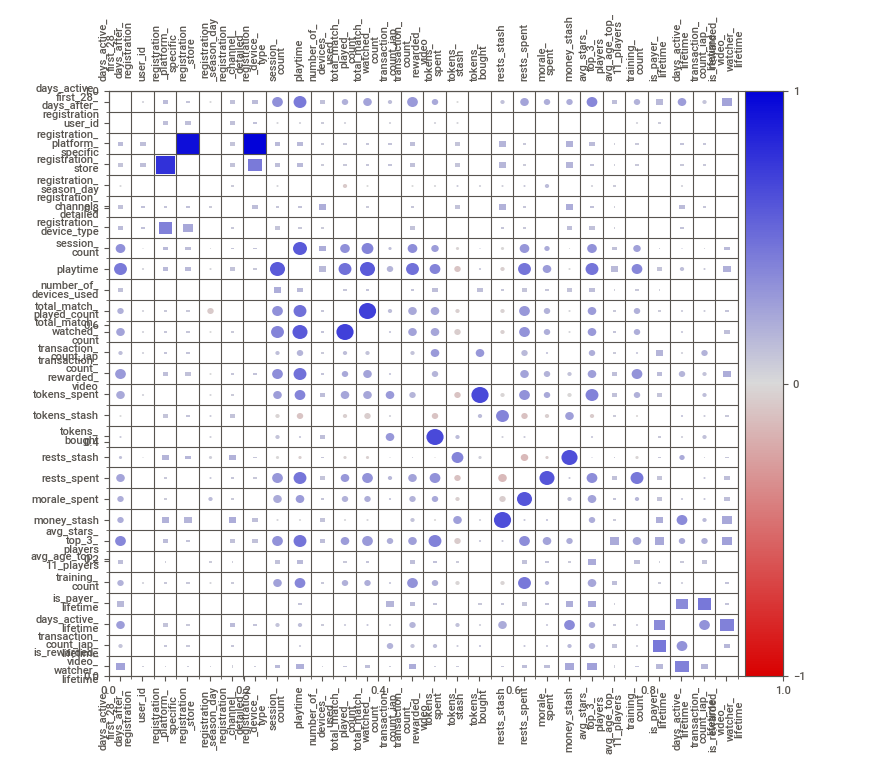
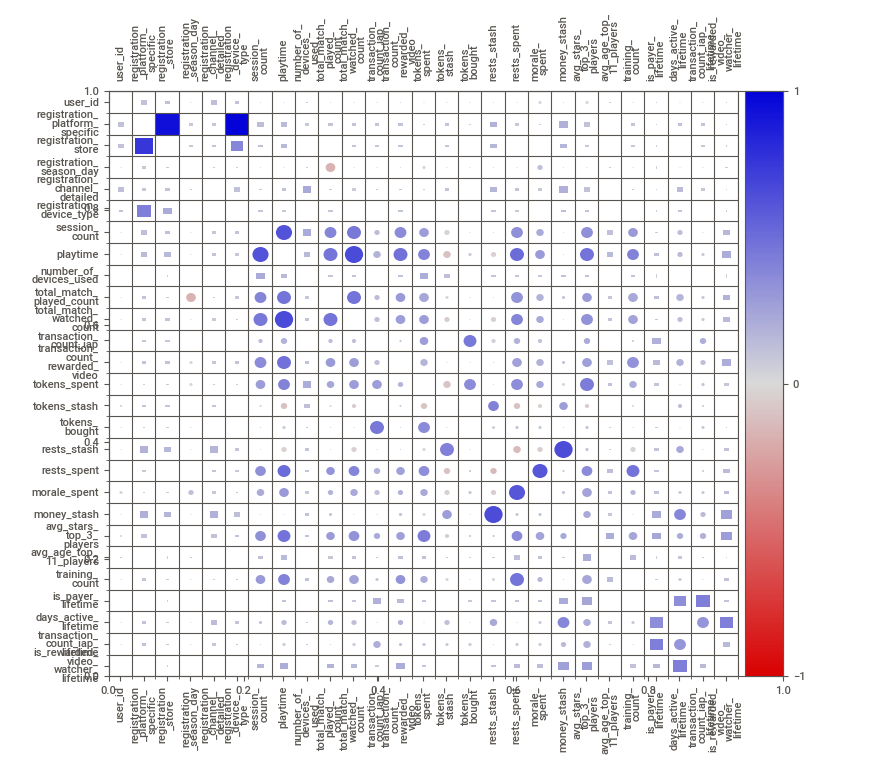

: 

In [ ]:
# Compare the training and test data
compare = sv.compare(source=training_data, compare=test_data, target_feat="days_active_first_28_days_after_registration")

# Show the result
compare.show_html(r'C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_compare.html')

compare.show_notebook(w=None,
                h=None,
                scale=None,
                layout='widescreen',
                filepath=None)

In [ ]:
# Identify categorical columns for encoding
categorical_columns = training_data.select_dtypes(include=['object']).columns.tolist()
categorical_columns

['registration_platform_specific',
 'registration_country',
 'registration_store',
 'registration_channel_detailed',
 'registration_device_type',
 'registration_device_manufacturer']

: 

In [ ]:
# Classify columns based on unique value counts
one_hot_cols = [col for col in categorical_columns if training_data[col].nunique() <= 5]
freq_encode_cols = [col for col in categorical_columns if training_data[col].nunique() > 5]

one_hot_cols, freq_encode_cols

(['registration_channel_detailed', 'registration_device_type'],
 ['registration_platform_specific',
  'registration_country',
  'registration_store',
  'registration_device_manufacturer'])

: 

In [ ]:
# Apply One-Hot Encoding for columns with few unique categories
training_data = pd.get_dummies(training_data, columns=one_hot_cols, drop_first=True)

# Apply Frequency Encoding for high-cardinality columns
for col in freq_encode_cols:
    freq_encoding = training_data[col].value_counts() / len(training_data)
    training_data[col] = training_data[col].map(freq_encoding)

: 

In [ ]:
# Convert boolean columns from one-hot encoding to integers
bool_columns = training_data.select_dtypes(include=['bool']).columns
training_data[bool_columns] = training_data[bool_columns].astype(int)

: 

In [ ]:
training_data.head().T

,0,1,2,3,4
user_id,5,7,13,23,25
registration_time_utc,2024-05-25 01:26:48,2024-06-14 20:09:31,2024-05-31 09:06:51,2024-05-31 04:00:33,2024-06-15 19:56:05
registration_platform_specific,0.2179,0.69598,0.69598,0.69598,0.2179
registration_country,0.03238,0.08944,0.00052,0.24036,0.01456
registration_store,0.24408,0.72034,0.72034,0.72034,0.24408
registration_season_day,7,27,13,13,28
registration_device_manufacturer,0.24136,0.1937,0.1937,0.06238,0.24136
session_count,1,1,2,4,5
playtime,2.351033,8.6959,28.386383,53.028333,97.782017
number_of_devices_used,1,1,1,1,1


: 

In [ ]:
# Save the encoded dataset
training_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed\encoded_training_data.csv", index=False)

: 

In [ ]:
# Calculate skewness for each numerical column in the training dataset
skewness = training_data.skew(numeric_only=True).sort_values(ascending=False)

# Display skewness values
skewness_df = skewness.to_frame(name='Skewness').reset_index()
skewness_df.columns = ['Feature', 'Skewness']
skewness_df

,Feature,Skewness
0,tokens_bought,167.048339
1,tokens_spent,52.981573
2,transaction_count_iap,22.600050
3,training_count,19.681952
4,tokens_stash,19.657883
5,transaction_count_iap_lifetime,17.238154
6,transaction_count_rewarded_video,6.918834
7,morale_spent,6.863805
8,total_match_watched_count,4.958619
9,total_match_played_count,4.316638


: 

In [ ]:
# Define a function to apply transformations based on skewness
def apply_transformations(data, skewed_features):
    transformed_data = data.copy()

    for feature in skewed_features:
        # Apply log transformation for features with extremely high skewness (>20)
        if skewed_features[feature] > 20:
            transformed_data[feature] = np.log1p(transformed_data[feature])  # log1p to handle zeros safely
    return transformed_data

# Identify features to transform based on skewness
skewed_features = {
    'tokens_bought': 167.048339,
    'tokens_spent': 52.981573,
    'transaction_count_iap': 22.600050
}

# Apply transformations based on skewness levels
registration_data_training_transformed = apply_transformations(training_data, skewed_features)

# Check if transformations were applied correctly
print(registration_data_training_transformed[skewed_features.keys()].describe())

       tokens_bought  tokens_spent  transaction_count_iap
count   50000.000000  50000.000000           50000.000000
mean        0.022794      2.186985               0.010595
std         0.306197      1.998812               0.107711
min         0.000000      0.000000               0.000000
25%         0.000000      0.000000               0.000000
50%         0.000000      2.397895               0.000000
75%         0.000000      4.262680               0.000000
max         9.105091      9.125109               2.772589


: 

In [ ]:
registration_data_training_transformed.skew(numeric_only=True).sort_values(ascending=False)

training_count                                  19.681952
tokens_stash                                    19.657883
transaction_count_iap_lifetime                  17.238154
tokens_bought                                   14.718797
transaction_count_iap                           11.856628
transaction_count_rewarded_video                 6.918834
morale_spent                                     6.863805
total_match_watched_count                        4.958619
total_match_played_count                         4.316638
registration_channel_detailed_Unknown            4.056813
session_count                                    3.836296
registration_device_type_Tablet                  3.789101
rests_spent                                      3.700693
playtime                                         3.589172
number_of_devices_used                           3.346028
days_active_lifetime                             3.084610
is_payer_lifetime                                2.288751
rests_stash   

: 

In [ ]:
# Define the target and features
X = training_data.drop(columns=['days_active_first_28_days_after_registration'], errors='ignore')
y = training_data['days_active_first_28_days_after_registration']

# Remove datetime columns from the feature set
X = X.select_dtypes(exclude=['datetime64[ns]'])

# Initialize the Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X, y)

# Get feature importance from the Random Forest model
feature_importances = pd.DataFrame({
    'Feature': X.columns,
    'Importance': rf_model.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Initialize RFE with the Random Forest model as the estimator
rfe_selector = RFE(estimator=rf_model, n_features_to_select=20, step=1)
rfe_selector.fit(X, y)

# Get the ranking of features from RFE
rfe_features = pd.DataFrame({
    'Feature': X.columns,
    'RFE_Ranking': rfe_selector.ranking_
}).sort_values(by='RFE_Ranking')

# Merge feature importance and RFE rankings for comparison
feature_selection_summary = pd.merge(feature_importances, rfe_features, on='Feature')

# Display the top 20 features based on both methods
feature_selection_summary.head(20)

,Feature,Importance,RFE_Ranking
0,playtime,0.304712,1
1,days_active_lifetime,0.094327,1
2,money_stash,0.069456,1
3,user_id,0.060412,1
4,rests_stash,0.054985,1
5,avg_stars_top_3_players,0.053701,1
6,tokens_stash,0.046488,1
7,registration_season_day,0.041254,1
8,tokens_spent,0.034585,1
9,registration_country,0.033743,1


: 

In [ ]:
# Set the tracking URI
mlflow.set_tracking_uri("file:/C:/Users/User/Projects_for_Competitions_Companies/Nordeus_Data_Science_Challenge_2024/logs")

# Set the experiment name
mlflow.set_experiment("Nordeus_Data_Science_Challenge")

: 

In [ ]:
# Define the selected features from RFE and the target variable
selected_features = [
    'playtime', 'days_active_lifetime', 'money_stash', 'user_id', 'rests_stash',
    'avg_stars_top_3_players', 'tokens_stash', 'registration_season_day', 'tokens_spent',
    'registration_country', 'registration_device_manufacturer', 'training_count',
    'rests_spent', 'session_count', 'transaction_count_rewarded_video', 'morale_spent',
    'avg_age_top_11_players', 'total_match_played_count', 'transaction_count_iap_lifetime'
]
target_variable = 'days_active_first_28_days_after_registration'

# Split the training data into train and validation sets
X = training_data[selected_features]
y = training_data[target_variable]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize MLflow for experiment tracking
mlflow.set_experiment("Nordeus_Data_Science_Challenge")

# Log the split data information
print("Train set size:", X_train.shape, "Validation set size:", X_val.shape)

: 

In [ ]:
# Initialize StandardScaler
scaler = StandardScaler()

# Fit the scaler on the training data and transform both training and validation sets
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)

# Verify the scaling by checking the mean and standard deviation of the scaled features
train_mean = X_train_scaled.mean(axis=0)
train_std = X_train_scaled.std(axis=0)

val_mean = X_val_scaled.mean(axis=0)
val_std = X_val_scaled.std(axis=0)

train_mean[:5], train_std[:5], val_mean[:5], val_std[:5]

: 

In [ ]:
# Directory path for processed data
processed_data_dir = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed"

# Save the scaled training data
with open(os.path.join(processed_data_dir, 'X_train_scaled.pkl'), 'wb') as f:
    pickle.dump(X_train_scaled, f)

# Save the scaled validation data
with open(os.path.join(processed_data_dir, 'X_val_scaled.pkl'), 'wb') as f:
    pickle.dump(X_val_scaled, f)

: 

In [ ]:
# Define a dictionary to store model performance
model_results = {}

# Define a helper function to evaluate and log models
def evaluate_model(model, model_name):
    with mlflow.start_run(run_name=model_name):
        # Cross-validate the model
        cv_mae = -cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean()

        # Log metrics
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("MAE", cv_mae)

        # Store results
        model_results[model_name] = {"MAE": cv_mae}

        # Log the model with input example
        mlflow.sklearn.log_model(model, model_name)

    print(f"{model_name}: MAE = {cv_mae:.4f}")

# 1. Linear Regression
linear_model = LinearRegression()
evaluate_model(linear_model, "Linear_Regression")

# 2. Ridge Regression
ridge_model = Ridge(alpha=1.0)
evaluate_model(ridge_model, "Ridge_Regression")

# 3. Lasso Regression
lasso_model = Lasso(alpha=0.1)
evaluate_model(lasso_model, "Lasso_Regression")

# 4. Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
evaluate_model(rf_model, "Random_Forest")

# 5. XGBoost Regressor
xgb_model = xgb.XGBRegressor(n_estimators=100, random_state=42)
evaluate_model(xgb_model, "XGBoost")

# 6. LightGBM Regressor
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42, force_row_wise=True)
evaluate_model(lgb_model, "LightGBM")

# 7. Initialize the Gradient Boosting Regressor
gbr_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
evaluate_model(gbr_model, "Gradient_Boosting")

: 

In [ ]:
# Define base models for ensemble methods
base_models = [
    ("Random_Forest", rf_model),
    ("XGBoost", xgb_model),
    ("LightGBM", lgb_model),
    ("Gradient_Boosting", gbr_model)
]

# 8. Voting Regressor (Ensemble of Tree-Based Models)
voting_regressor = VotingRegressor(estimators=base_models)
evaluate_model(voting_regressor, "Voting_Regressor")

# 9. Stacking Regressor (Ensemble of Tree-Based Models and Linear Regression)
stacking_regressor = StackingRegressor(
    estimators=base_models,
    final_estimator=LinearRegression()
)
evaluate_model(stacking_regressor, "Stacking_Regressor")

: 

In [ ]:
# Display the updated model results after ensemble model training
model_results

: 

In [ ]:
# Define a helper function to evaluate deep learning models
def evaluate_dl_model(model, model_name, X_train, y_train, X_val, y_val):
    with mlflow.start_run(run_name=model_name):
        # Compile the model
        model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_absolute_error')

        # Train the model
        history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=32, verbose=0)

        # Make predictions on the validation set
        y_pred = model.predict(X_val)

        # Calculate metrics
        mae = mean_absolute_error(y_val, y_pred)

        # Log metrics to MLflow
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("MAE", mae)

        # Log the model
        mlflow.keras.log_model(model, model_name)

        print(f"{model_name}: MAE = {mae:.4f}")

# Define a Feedforward Neural Network model
def build_ffnn(input_dim):
    model = Sequential([
        Input(shape=(input_dim,)),
        Dense(128, activation='relu'),
        Dropout(0.3),
        Dense(64, activation='relu'),
        Dropout(0.3),
        Dense(32, activation='relu'),
        Dense(1)
    ])
    return model

# Build and evaluate the Feedforward Neural Network model
input_dim = X_train_scaled.shape[1]
ffnn_model = build_ffnn(input_dim)
evaluate_dl_model(ffnn_model, "Feedforward_Neural_Network", X_train_scaled, y_train, X_val_scaled, y_val)

: 

In [ ]:
# Define an objective function for the Feedforward Neural Network
def objective_ffnn(trial):
    # Hyperparameter suggestions
    n_layers = trial.suggest_int("n_layers", 2, 4)
    n_neurons = trial.suggest_int("n_neurons", 32, 256)
    dropout_rate = trial.suggest_float("dropout_rate", 0.1, 0.5)
    learning_rate = trial.suggest_float("learning_rate", 1e-5, 1e-2)
    epochs = trial.suggest_int("epochs", 20, 100)
    batch_size = trial.suggest_int("batch_size", 16, 64)

    # Build the model
    model = Sequential()
    model.add(Input(shape=(X_train_scaled.shape[1],)))
    model.add(Dense(n_neurons, activation='relu'))
    model.add(Dropout(dropout_rate))
    for _ in range(n_layers - 1):
        model.add(Dense(n_neurons, activation='relu'))
        model.add(Dropout(dropout_rate))
    model.add(Dense(1))  # Output layer

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mean_absolute_error')

    # Train the model
    history = model.fit(X_train_scaled, y_train, validation_data=(X_val_scaled, y_val),
                        epochs=epochs, batch_size=batch_size, verbose=0)

    # Evaluate the model
    y_pred = model.predict(X_val_scaled).flatten()
    mae = mean_absolute_error(y_val, y_pred)

    return mae

: 

In [ ]:
# Define the objective function for LightGBM tuning
def objective_lgb(trial):
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 200, 1200),
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 150),
        "max_depth": trial.suggest_int("max_depth", 3, 15),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 40),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0.01, 0.1),
        "subsample": trial.suggest_float("subsample", 0.6, 0.9),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 0.9),
        "lambda_l1": trial.suggest_float("lambda_l1", 0.0, 10.0),
        "lambda_l2": trial.suggest_float("lambda_l2", 0.0, 10.0),
        "random_state": 42,
        "force_row_wise": True,
        "verbosity": -1,
    }

    # Initialize and train the model
    model = lgb.LGBMRegressor(**param)
    model.fit(
      X_train, y_train,
      eval_set=[(X_val, y_val)],
      callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
    )

    # Predict and evaluate
    y_pred = model.predict(X_val)
    mae = mean_absolute_error(y_val, y_pred)

    return mae

: 

In [ ]:
# Initialize MLflow experiment
mlflow.set_experiment("Optuna_Hyperparameter_Tuning")

# Run Bayesian Optimization with Optuna for Feedforward Neural Network
sampler = optuna.samplers.RandomSampler()
ffnn_study = optuna.create_study(direction="minimize", sampler=sampler)
ffnn_study.optimize(objective_ffnn, n_trials=50)

# Log the best FFNN model parameters
mlflow.log_params(ffnn_study.best_params)
mlflow.log_metric("Best_MAE_FFNN", ffnn_study.best_value)

: 

In [ ]:
# Run Bayesian Optimization with Optuna for LightGBM model
sampler = optuna.samplers.RandomSampler()
lgb_study = optuna.create_study(direction="minimize", sampler=sampler)
lgb_study.optimize(objective_lgb, n_trials=100)

# Print the best parameters
print("Best MAE:", lgb_study.best_value)
print("Best parameters:", lgb_study.best_params)

: 

In [ ]:
# Display the best hyperparameters and MAE for both models
best_ffnn_params = ffnn_study.best_params
best_ffnn_mae = ffnn_study.best_value

best_lgb_params = lgb_study.best_params
best_lgb_mae = lgb_study.best_value

print(f"Best FFNN parameters and MAE : \n{best_ffnn_params, best_ffnn_mae}"),
print(f"\nBest LightGBM parameters and MAE : \n{best_lgb_params, best_lgb_mae}")

: 

In [ ]:
# Add fixed parameters
best_lgb_params.update({
    "random_state": 42,
    "force_row_wise": True,
    "verbosity": -1
})

: 

In [ ]:
# Get feature names from the training DataFrame
feature_names = X_train.columns

# Retrain the tuned LightGBM model with feature names
tuned_lgb_model = lgb.LGBMRegressor(**best_lgb_params)
tuned_lgb_model.fit(
    X_train_scaled, y_train,
    eval_set=[(X_val_scaled, y_val)],
    feature_name=feature_names.tolist(),
    callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
)

: 

In [ ]:
# Make predictions on the validation set
y_pred = tuned_lgb_model.predict(X_val_scaled)

# Calculate the Mean Absolute Error (MAE)
mae = mean_absolute_error(y_val, y_pred)

print(f"Tuned LightGBM Model MAE: {mae:.4f}")

: 

In [ ]:
# Plot feature importance using the tuned LightGBM model
lgb.plot_importance(tuned_lgb_model, max_num_features=15, importance_type='gain', ignore_zero=True, figsize=(14, 6))
plt.title("Tuned LightGBM Feature Importance (Top 15 Features)")
plt.xlabel("Feature Importance (Gain)")
plt.ylabel("Feature")
plt.show()

: 

In [ ]:
# Convert the scaled validation data back to a DataFrame
X_val_scaled_df = pd.DataFrame(X_val_scaled, columns=X_train.columns)

# Initialize the SHAP explainer with the tuned LightGBM model
explainer = shap.TreeExplainer(tuned_lgb_model)
shap_values = explainer.shap_values(X_val_scaled_df)

# Create a SHAP summary plot (bar plot)
shap.summary_plot(shap_values, X_val_scaled_df, plot_type="bar", show=False)
plt.title("SHAP Feature Importance for Tuned LightGBM")
plt.show()

: 

In [ ]:
mlflow.end_run()

with mlflow.start_run(run_name="Tuned_LightGBM_Interpretability"):
    # Log the tuned LightGBM model
    mlflow.log_params(best_lgb_params)
    mlflow.sklearn.log_model(tuned_lgb_model, "Tuned_LightGBM_Model")

    # Log LightGBM Feature Importance Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    lgb.plot_importance(tuned_lgb_model, max_num_features=20, importance_type='gain', ax=ax)
    plt.title("Tuned LightGBM Feature Importance (Top 20 Features)")
    plt.savefig("tuned_lgb_feature_importance.png")
    mlflow.log_artifact("tuned_lgb_feature_importance.png")

    # Log SHAP Summary Plot
    plt.figure()
    shap.summary_plot(shap_values, X_val, plot_type="bar", show=False)
    plt.savefig("tuned_shap_summary_plot.png")
    mlflow.log_artifact("tuned_shap_summary_plot.png")

print("Feature importance plots logged to MLflow.")

: 

In [ ]:
# Initialize PCA
pca = PCA()

# Fit PCA on the scaled training data
pca.fit(X_train_scaled)

# Plot the explained variance ratio to determine the number of components
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Explained Variance vs. Number of Principal Components")
plt.grid()
plt.show()

: 

In [ ]:
# Initialize PCA with the selected number of components
pca = PCA(n_components=0.9)

# Fit PCA on the training data and transform both training and validation sets
X_train_pca = pca.fit_transform(X_train_scaled)
X_val_pca = pca.transform(X_val_scaled)

print(f"Reduced dimensions: {X_train_pca.shape[1]}")

: 

In [ ]:
# Retrain the LightGBM model using PCA-transformed data
pca_lgb_model = lgb.LGBMRegressor(**best_lgb_params)
pca_lgb_model.fit(
    X_train_pca, y_train,
    eval_set=[(X_val_pca, y_val)],
    callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
)

# Evaluate the model
y_pred_pca = pca_lgb_model.predict(X_val_pca)
mae_pca = mean_absolute_error(y_val, y_pred_pca)

print(f"Tuned LightGBM Model MAE with PCA: {mae_pca:.4f}")

: 

In [ ]:
# Print the comparison of MAE
print(f"Original Tuned LightGBM MAE: {mae:.4f}")
print(f"\nTuned LightGBM MAE with PCA: {mae_pca:.4f}")

: 

In [ ]:
# Save the final model
joblib.dump(tuned_lgb_model, r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\tuned_lgb_model.pkl")
print("Tuned LightGBM model saved as 'tuned_lgb_model.pkl'")

: 

In [ ]:
# Rebuild the FFNN model using the best parameters from Optuna
def build_best_ffnn(params):
    model = Sequential()
    model.add(Input(shape=(X_train_scaled.shape[1],)))
    model.add(Dense(params['n_neurons'], activation='relu'))
    model.add(Dropout(params['dropout_rate']))
    for _ in range(params['n_layers'] - 1):
        model.add(Dense(params['n_neurons'], activation='relu'))
        model.add(Dropout(params['dropout_rate']))
    model.add(Dense(1))  # Output layer for regression

    # Compile the model
    optimizer = Adam(learning_rate=params['learning_rate'])
    model.compile(optimizer=optimizer, loss='mean_absolute_error')

    return model

# Rebuild the FFNN model using the best parameters
best_ffnn_model = build_best_ffnn(best_ffnn_params)

# Train the model
history = best_ffnn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    epochs=best_ffnn_params['epochs'],
    batch_size=best_ffnn_params['batch_size'],
    verbose=1
)

# Save the model using the native Keras format
best_ffnn_model.save("best_ffnn_model.keras")
print("Best FFNN model saved as 'best_ffnn_model.keras'")

: 